In [13]:
import numpy as np
from api import  Benchmark

import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.pyplot as plt
from matplotlib import cm

import seaborn as sns
import json


In [14]:
bench_dir = "../../experiments/benchmarks/data_2k_lw.json"
bench = Benchmark(bench_dir, cache=False)

==> Loading data...
==> No cached data found or cache set to False.
==> Reading json data...
==> Done.


In [15]:

# Specify the filename
filename = '../../experiments/benchmarks/dataset_names.json'

# Load the keys from the JSON file
with open(filename, 'r') as json_file:
    dataset_names = json.load(json_file)
    dataset_names.sort()

# Print the loaded keys
print("Loaded keys:", dataset_names)


Loaded keys: ['APSFailure', 'Amazon_employee_access', 'Australian', 'Fashion-MNIST', 'KDDCup09_appetency', 'MiniBooNE', 'adult', 'airlines', 'albert', 'bank-marketing', 'blood-transfusion-service-center', 'car', 'christine', 'cnae-9', 'connect-4', 'covertype', 'credit-g', 'dionis', 'fabert', 'helena', 'higgs', 'jannis', 'jasmine', 'jungle_chess_2pcs_raw_endgame_complete', 'kc1', 'kr-vs-kp', 'mfeat-factors', 'nomao', 'numerai28.6', 'phoneme', 'segment', 'shuttle', 'sylvine', 'vehicle', 'volkert']


In [16]:
# Plot all the accuracies over epoch # by dataset
dataset_test_name = dataset_names[3] # mnist
n_configs = bench.get_number_of_configs(dataset_name=dataset_test_name)
epochs = bench.query(dataset_name=dataset_test_name, tag='epoch', config_id=1)


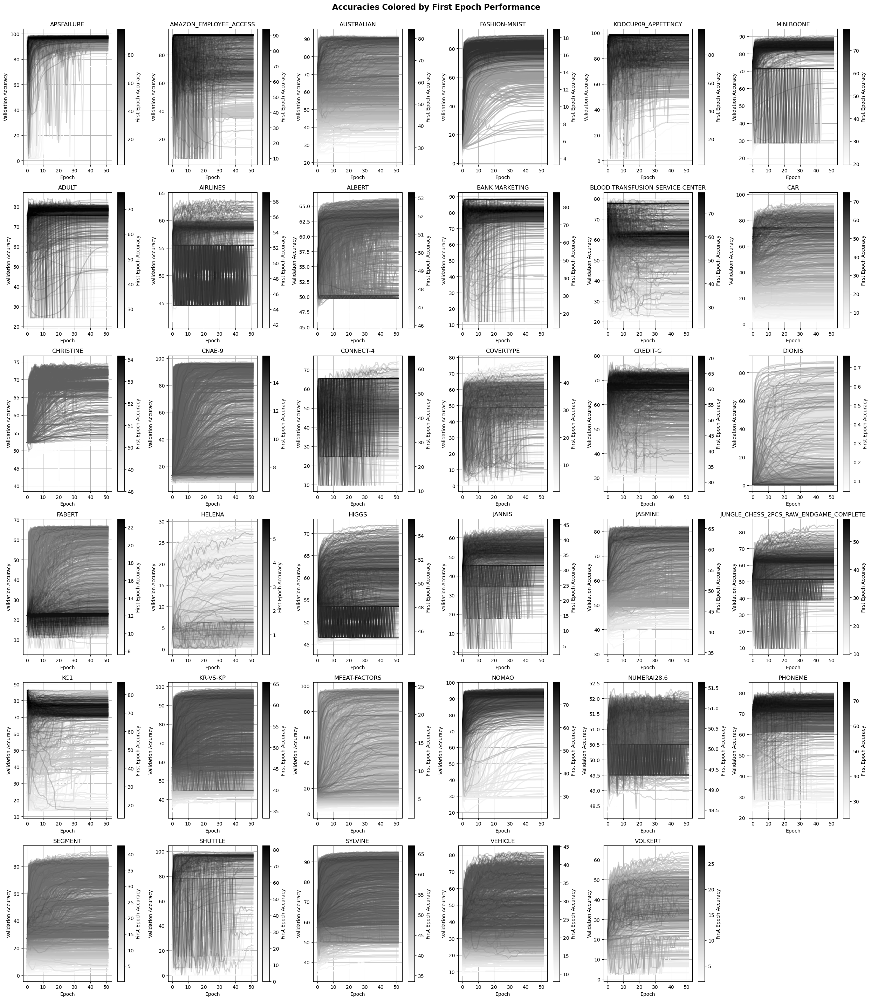

In [17]:

# Collect all accuracies and their first-epoch scores for each dataset
all_accuracies = []
first_epoch_scores = []

# Assuming the datasets are already defined
for dataset_name in dataset_names:
    # Initialize lists for each dataset
    accuracies_for_dataset = []
    first_epoch_scores_for_dataset = []
    n_configs = bench.get_number_of_configs(dataset_name=dataset_name)
    
    for c in range(n_configs):
        acc = bench.query(dataset_name=dataset_name, tag="Train/val_accuracy", config_id=c)
        accuracies_for_dataset.append(acc)
        first_epoch_scores_for_dataset.append(acc[0])
    all_accuracies.append(accuracies_for_dataset)
    first_epoch_scores.append(first_epoch_scores_for_dataset)

# Create subplots for each dataset, aiming for 4 columns
n_datasets = len(dataset_names)
n_cols = 6
n_rows = (n_datasets + n_cols - 1) // n_cols  # Calculate the number of rows needed

# Create a grid of subplots with `n_rows` and `n_cols`
fig, axes = plt.subplots(n_rows, n_cols, figsize=(25, 5 * n_rows))

# Flatten the axes array for easy indexing
axes = axes.flatten()

# Loop through each dataset and plot its data
for i, dataset_name in enumerate(dataset_names):
    accuracies = all_accuracies[i]
    first_epoch_scores_for_dataset = first_epoch_scores[i]

    # Sort by first epoch accuracy (descending)
    sorted_indices = np.argsort(-np.array(first_epoch_scores_for_dataset))

    # Normalize colors to ensure top performers (first epoch accuracy) are mapped to black
    norm = mcolors.Normalize(vmin=min(first_epoch_scores_for_dataset), vmax=max(first_epoch_scores_for_dataset))
    cmap = plt.cm.Greys

    # Get the corresponding axis for this dataset
    ax = axes[i]

    # Plot lines ordered by first epoch accuracy, with top performers in black
    for idx in sorted_indices[::-1]:  # Reverse the order to plot top performers last (on top)
        acc = accuracies[idx]
        color = cmap(norm(first_epoch_scores_for_dataset[idx]))  # Grayscale color based on first epoch score
        alpha = 1.0 - (first_epoch_scores_for_dataset[idx] - min(first_epoch_scores_for_dataset)) / (max(first_epoch_scores_for_dataset) - min(first_epoch_scores_for_dataset))  # Decrease alpha for lower performers
        # Plot the accuracy curves in the order of their first epoch score
        ax.plot(epochs, acc, color=color, alpha=alpha, linewidth=2)

    # Add colorbar for each dataset subplot
    sm = cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])  # Needed for colorbar creation
    cbar = fig.colorbar(sm, ax=ax)
    cbar.set_label('First Epoch Accuracy')

    # Set title and labels for each subplot
    ax.set_title(f"{dataset_name.upper()}")
    ax.set_xlabel("Epoch")
    ax.set_ylabel("Validation Accuracy")
    ax.grid(True)

# Hide any unused axes if there are fewer datasets than the total number of axes
for i in range(n_datasets, len(axes)):
    axes[i].axis('off')

# Final formatting
fig.suptitle('Accuracies Colored by First Epoch Performance',fontsize=16, fontweight='bold', y=0.98)
fig.tight_layout(rect=[0, 0.03, 1, 0.98])
plt.savefig('../../figures/Colored Accuracies 35ds.png', format='png', dpi=150, bbox_inches='tight')

plt.show()


In [7]:
six_datasets = ['Fashion-MNIST', 'adult', 'higgs', 'jasmine', 'vehicle', 'volkert']

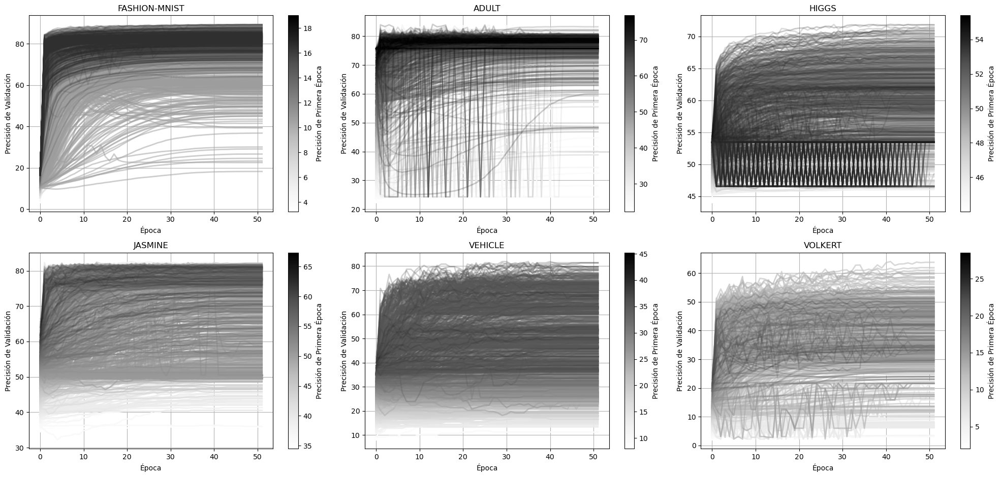

In [ ]:

# Collect all accuracies and their first-epoch scores for each dataset
all_accuracies = []
first_epoch_scores = []

# Assuming the datasets are already defined
for dataset_name in six_datasets:
    # Initialize lists for each dataset
    accuracies_for_dataset = []
    first_epoch_scores_for_dataset = []
    for c in range(n_configs):
        acc = bench.query(dataset_name=dataset_name, tag="Train/val_accuracy", config_id=c)
        accuracies_for_dataset.append(acc)
        first_epoch_scores_for_dataset.append(acc[0]) # !
    all_accuracies.append(accuracies_for_dataset)
    first_epoch_scores.append(first_epoch_scores_for_dataset)

# Create subplots for each dataset, aiming for 4 columns
n_datasets = len(six_datasets)
n_cols = 3
n_rows = (n_datasets + n_cols - 1) // n_cols  # Calculate the number of rows needed

# Create a grid of subplots with `n_rows` and `n_cols`
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows))

# Flatten the axes array for easy indexing
axes = axes.flatten()

# Loop through each dataset and plot its data
for i, dataset_name in enumerate(six_datasets):
    accuracies = all_accuracies[i]
    first_epoch_scores_for_dataset = first_epoch_scores[i]

    # Sort by first epoch accuracy (descending)
    sorted_indices = np.argsort(-np.array(first_epoch_scores_for_dataset))

    # Normalize colors to ensure top performers (first epoch accuracy) are mapped to black
    norm = mcolors.Normalize(vmin=min(first_epoch_scores_for_dataset), vmax=max(first_epoch_scores_for_dataset))
    cmap = plt.cm.Greys

    # Get the corresponding axis for this dataset
    ax = axes[i]

    # Plot lines ordered by first epoch accuracy, with top performers in black
    for idx in sorted_indices[::-1]:  # Reverse the order to plot top performers last (on top)
        acc = accuracies[idx]
        color = cmap(norm(first_epoch_scores_for_dataset[idx]))  # Grayscale color based on first epoch score
        alpha = 1.0 - (first_epoch_scores_for_dataset[idx] - min(first_epoch_scores_for_dataset)) / (max(first_epoch_scores_for_dataset) - min(first_epoch_scores_for_dataset))  # Decrease alpha for lower performers
        # Plot the accuracy curves in the order of their first epoch score
        ax.plot(epochs, acc, color=color, alpha=alpha, linewidth=2)

    # Add colorbar for each dataset subplot
    sm = cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])  # Needed for colorbar creation
    cbar = fig.colorbar(sm, ax=ax)
    cbar.set_label('Precisión de Primera Época')

    # Set title and labels for each subplot
    ax.set_title(f"{dataset_name.upper()}")
    ax.set_xlabel("Época")
    ax.set_ylabel("Precisión de Validación")
    ax.grid(True)

# Hide any unused axes if there are fewer datasets than the total number of axes
for i in range(n_datasets, len(axes)):
    axes[i].axis('off')

# Final formatting
# fig.suptitle('Precisiones Coloreadas por el Rendimiento de la Primera Época',fontsize=16, fontweight='bold', y=0.98)
fig.tight_layout(rect=[0, 0.03, 1, 0.98])
plt.savefig('../../figures/LC Accuracies by OE_6ds.png', format='png', dpi=150, bbox_inches='tight')
plt.show()


# For One Epoch

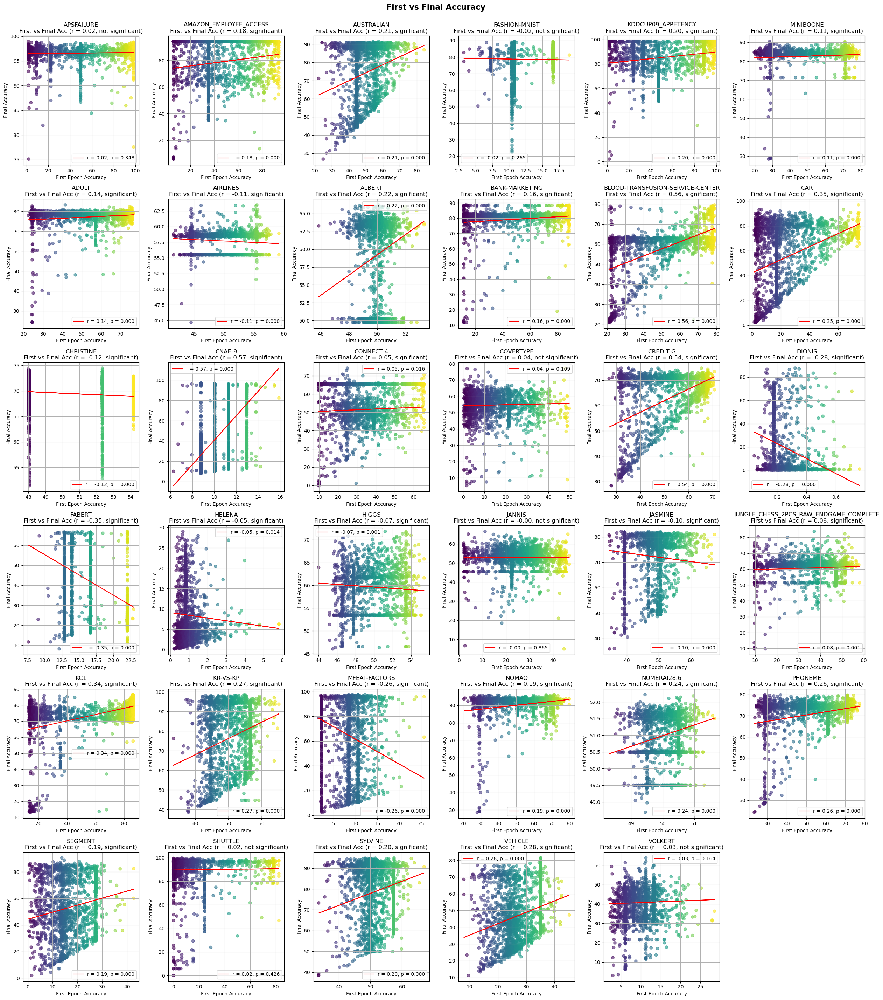

In [18]:
from scipy.stats import linregress

# Assuming `dataset_names` is a list of dataset names and `all_accuracies` is a list of accuracy data for each dataset
n_datasets = len(dataset_names)
n_cols = 6  # Define the number of columns per row
n_rows = (n_datasets + n_cols - 1) // n_cols  # Compute the number of rows needed

# Create subplots for each dataset, aiming for 4 columns
fig, axes = plt.subplots(n_rows, n_cols, figsize=(25, 5 * n_rows))

# Flatten the axes array for easy indexing
axes = axes.flatten()

for i, dataset_name in enumerate(dataset_names):
    first_acc = [acc[0] for acc in all_accuracies[i]]
    final_acc = [acc[-1] for acc in all_accuracies[i]]

    ax = axes[i]
    ax.scatter(first_acc, final_acc, c=first_acc, cmap='viridis', alpha=0.6)

    # Linear regression
    slope, intercept, r_value, p_value, std_err = linregress(first_acc, final_acc)
    line_x = np.array(first_acc)
    ax.plot(line_x, slope * line_x + intercept, color='red', label=f"r = {r_value:.2f}, p = {p_value:.3f}")
    ax.legend()

    # Add title with significance
    significance = "significant" if p_value < 0.05 else "not significant"
    ax.set_title(f"{dataset_name.upper()}\nFirst vs Final Acc (r = {r_value:.2f}, {significance})")
    ax.set_xlabel("First Epoch Accuracy")
    ax.set_ylabel("Final Accuracy")
    ax.grid(True)

# Hide unused axes
for j in range(n_datasets, len(axes)):
    axes[j].axis('off')

# Final layout adjustments
fig.suptitle('First vs Final Accuracy',fontsize=16, fontweight='bold', y=0.98)
fig.tight_layout(rect=[0, 0.03, 1, 0.98])
plt.savefig('../../figures/LC Correlation in OE_35ds.png', format='png', dpi=150, bbox_inches='tight')
plt.show()


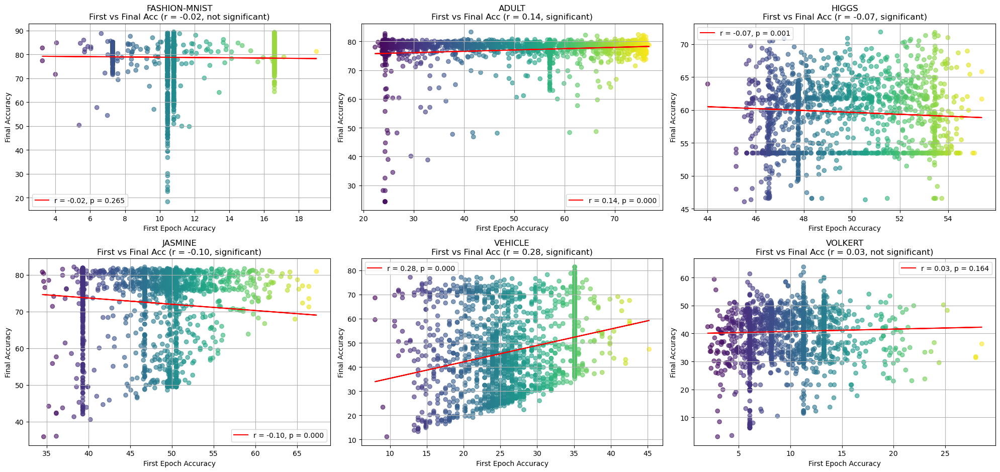

In [ ]:
from scipy.stats import linregress

# Assuming `dataset_names` is a list of dataset names and `all_accuracies` is a list of accuracy data for each dataset
n_datasets = len(six_datasets)
n_cols = 3  # Define the number of columns per row
n_rows = (n_datasets + n_cols - 1) // n_cols  # Compute the number of rows needed

# Create subplots for each dataset, aiming for 4 columns
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5 * n_rows))

# Flatten the axes array for easy indexing
axes = axes.flatten()

for i, dataset_name in enumerate(six_datasets):
    first_acc = [acc[0] for acc in all_accuracies[i]]
    final_acc = [acc[-1] for acc in all_accuracies[i]]

    ax = axes[i]
    ax.scatter(first_acc, final_acc, c=first_acc, cmap='viridis', alpha=0.6)

    # Linear regression
    slope, intercept, r_value, p_value, std_err = linregress(first_acc, final_acc)
    line_x = np.array(first_acc)
    ax.plot(line_x, slope * line_x + intercept, color='red', label=f"r = {r_value:.2f}, p = {p_value:.3f}")
    ax.legend()

    # Add title with significance
    significance = "significant" if p_value < 0.05 else "not significant"
    ax.set_title(f"{dataset_name.upper()}\nFirst vs Final Acc (r = {r_value:.2f}, {significance})")
    ax.set_xlabel("First Epoch Accuracy")
    ax.set_ylabel("Final Accuracy")
    ax.grid(True)

# Hide unused axes
for j in range(n_datasets, len(axes)):
    axes[j].axis('off')

# Final layout adjustments
# fig.suptitle('First vs Final Accuracy',fontsize=16, fontweight='bold', y=0.98)
fig.tight_layout(rect=[0, 0.03, 1, 0.98])
plt.savefig('../../figures/LC Correlation in OE_6ds.png', format='png', dpi=300, bbox_inches='tight')
plt.show()


# For N epochs

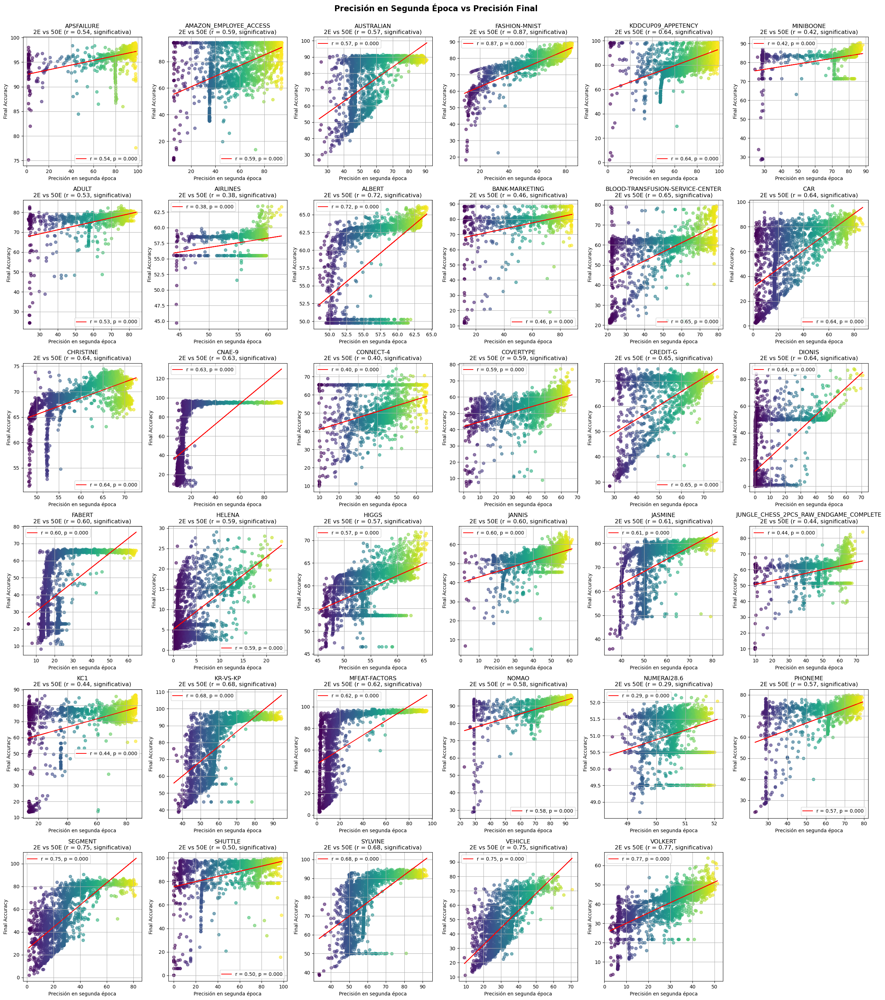

In [19]:
from scipy.stats import linregress

# Assuming `dataset_names` is a list of dataset names and `all_accuracies` is a list of accuracy data for each dataset
n_datasets = len(dataset_names)
n_cols = 6  # Define the number of columns per row
n_rows = (n_datasets + n_cols - 1) // n_cols  # Compute the number of rows needed

# Create subplots for each dataset, aiming for 4 columns
fig, axes = plt.subplots(n_rows, n_cols, figsize=(25, 5 * n_rows))

# Flatten the axes array for easy indexing
axes = axes.flatten()

for i, dataset_name in enumerate(dataset_names):
    first_acc = [acc[1] for acc in all_accuracies[i]] #!
    final_acc = [acc[-1] for acc in all_accuracies[i]]

    ax = axes[i]
    ax.scatter(first_acc, final_acc, c=first_acc, cmap='viridis', alpha=0.6)

    # Linear regression
    slope, intercept, r_value, p_value, std_err = linregress(first_acc, final_acc)
    line_x = np.array(first_acc)
    ax.plot(line_x, slope * line_x + intercept, color='red', label=f"r = {r_value:.2f}, p = {p_value:.3f}")
    ax.legend()

    # Add title with significance
    significance = "significativa" if p_value < 0.05 else "no significativa"
    ax.set_title(f"{dataset_name.upper()}\n2E vs 50E (r = {r_value:.2f}, {significance})")
    ax.set_xlabel("Precisión en segunda época")
    ax.set_ylabel("Final Accuracy")
    ax.grid(True)

# Hide unused axes
for j in range(n_datasets, len(axes)):
    axes[j].axis('off')

# Final layout adjustments
fig.suptitle('Precisión en Segunda Época vs Precisión Final',fontsize=16, fontweight='bold', y=0.98)
fig.tight_layout(rect=[0, 0.03, 1, 0.98])
plt.savefig('../../figures/LC Correlation in 2E_35ds.png', format='png', dpi=150, bbox_inches='tight')
plt.show()


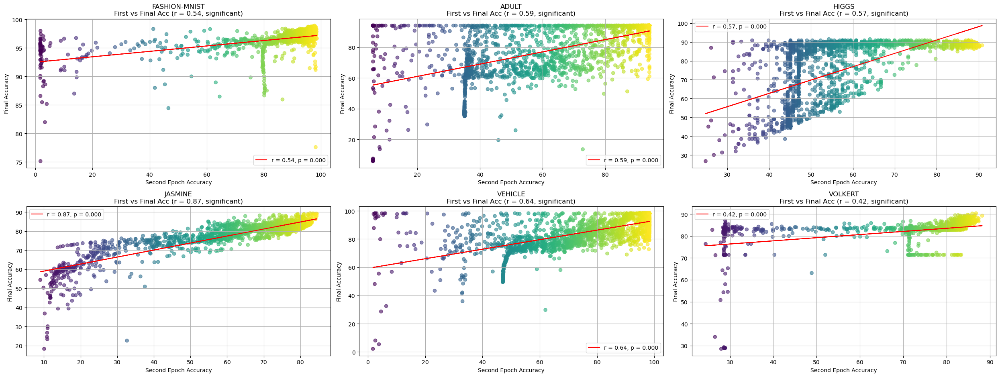

In [105]:
# Assuming `dataset_names` is a list of dataset names and `all_accuracies` is a list of accuracy data for each dataset
n_datasets = len(six_datasets)
n_cols = 3  # Define the number of columns per row
n_rows = (n_datasets + n_cols - 1) // n_cols  # Compute the number of rows needed

# Create subplots for each dataset, aiming for 4 columns
fig, axes = plt.subplots(n_rows, n_cols, figsize=(25, 5 * n_rows))

# Flatten the axes array for easy indexing
axes = axes.flatten()

for i, dataset_name in enumerate(six_datasets):
    first_acc = [acc[1] for acc in all_accuracies[i]] #!
    final_acc = [acc[-1] for acc in all_accuracies[i]]

    ax = axes[i]
    ax.scatter(first_acc, final_acc, c=first_acc, cmap='viridis', alpha=0.6)

    # Linear regression
    slope, intercept, r_value, p_value, std_err = linregress(first_acc, final_acc)
    line_x = np.array(first_acc)
    ax.plot(line_x, slope * line_x + intercept, color='red', label=f"r = {r_value:.2f}, p = {p_value:.3f}")
    ax.legend()

    # Add title with significance
    significance = "significant" if p_value < 0.05 else "not significant"
    ax.set_title(f"{dataset_name.upper()}\nFirst vs Final Acc (r = {r_value:.2f}, {significance})")
    ax.set_xlabel("Second Epoch Accuracy")
    ax.set_ylabel("Final Accuracy")
    ax.grid(True)

# Hide unused axes
for j in range(n_datasets, len(axes)):
    axes[j].axis('off')

# Final layout adjustments
# fig.suptitle('Second Epoch vs Final Accuracy',fontsize=16, fontweight='bold', y=0.98)
fig.tight_layout(rect=[0, 0.03, 1, 0.98])
plt.savefig('../../figures/LC Correlation in 2E_6ds.png', format='png', dpi=300, bbox_inches='tight')
plt.show()


maybe build a gif, dont know why for tho.
check the code for acc definition so that each cell is not affecting the havior of the others.

# Map top performers

In [21]:
import pandas as pd

lcbench_df = pd.read_csv('../../experiments/results/all_datasets_benchmark.csv')

In [22]:
# Build a dict with the values
dataset_names_df = lcbench_df['dataset_name'].unique().tolist()

datasets = {}
for dataset_name in dataset_names_df:
    datasets[dataset_name] = lcbench_df[lcbench_df['dataset_name'] == dataset_name].copy()

In [62]:
datasets['Fashion-MNIST']

,config_id,dataset_name,time,epoch,Train/loss,Train/train_accuracy,Train/val_accuracy,Train/train_cross_entropy,Train/val_cross_entropy,Train/train_balanced_accuracy,...,optimizer,cosine_annealing_T_max,cosine_annealing_eta_min,activation,max_units,mlp_shape,num_layers,learning_rate,momentum,weight_decay
44000,0,Fashion-MNIST,"[0.0002892017364501953, 9.520127534866331, 26....","[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[2.314540386199951, 1.9220430850982664, 1.2010...","[11.106867790222168, 50.709693908691406, 66.00...","[10.808890342712402, 62.20441818237305, 69.595...","[2.31477952003479, 1.925082087516785, 1.207342...","[2.315356969833374, 1.5003297328948977, 1.0052...","[0.11164481192827223, 0.5111237168312073, 0.66...",...,sgd,50,1.000000e-08,relu,293,funnel,3,0.001824,0.213252,0.020473
44001,1,Fashion-MNIST,"[0.00046706199645996094, 9.748942136764525, 31...","[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[2.3030104637146, 2.2660892009735107, 2.191473...","[11.29781723022461, 20.29469871520996, 37.0536...","[11.202998161315918, 48.087608337402344, 53.46...","[2.302178382873535, 2.2663445472717285, 2.1924...","[2.302541494369507, 2.2219974994659424, 2.1174...","[0.11283209174871445, 0.2039981633424759, 0.37...",...,sgd,50,1.000000e-08,relu,950,funnel,4,0.012393,0.164114,0.097628
44002,2,Fashion-MNIST,"[0.0004332065582275391, 3.896085500717163, 7.7...","[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[2.651860475540161, 2.2369251251220703, 1.6800...","[7.571128368377685, 18.595251083374023, 49.077...","[7.294224262237549, 36.80707931518555, 56.9130...","[2.6494920253753658, 2.23682713508606, 1.68321...","[2.6503214836120605, 1.8900952339172363, 1.510...","[0.07452084869146347, 0.1854720264673233, 0.49...",...,sgd,50,1.000000e-08,relu,623,funnel,True,0.000210,0.391250,0.052986
44003,3,Fashion-MNIST,"[0.00046443939208984375, 7.325477600097656, 21...","[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[2.5635485649108887, 2.5195040702819824, 2.463...","[11.106867790222168, 10.040736198425293, 10.55...","[10.808890342712402, 18.206485748291016, 25.53...","[2.31477952003479, 2.519888401031494, 2.464506...","[2.315356969833374, 2.285114288330078, 2.25888...","[0.11164481192827223, 0.1006937175989151, 0.10...",...,sgd,50,1.000000e-08,relu,712,funnel,3,0.000499,0.102648,0.043053
44004,4,Fashion-MNIST,"[0.00042510032653808594, 4.980403661727905, 9....","[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[2.6517117023468018, 1.044159173965454, 0.7059...","[7.571128368377685, 67.21086883544922, 76.6055...","[7.294224262237549, 74.82232666015625, 77.8201...","[2.6494920253753658, 1.048811674118042, 0.7103...","[2.6503214836120605, 0.7758839130401611, 0.673...","[0.07452084869146347, 0.674390971660614, 0.767...",...,sgd,50,1.000000e-08,relu,252,funnel,True,0.000267,0.165046,0.041857
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45995,1995,Fashion-MNIST,"[0.0004737377166748047, 6.777889728546143, 18....","[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[2.3010153770446777, 2.103980541229248, 1.7952...","[16.625293731689453, 27.891286849975586, 47.98...","[16.59775161743164, 56.53185272216797, 62.2754...","[2.2580790519714355, 2.105499267578125, 1.7988...","[2.258861780166626, 1.8906463384628296, 1.6377...","[0.16819120943546295, 0.2807975709438324, 0.48...",...,sgd,50,1.000000e-08,relu,325,funnel,2,0.000246,0.438175,0.084043
45996,1996,Fashion-MNIST,"[0.0001847743988037109, 7.402123212814331, 23....","[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[2.3142294883728027, 2.2852230072021484, 2.236...","[11.186429977416992, 15.11679744720459, 24.651...","[10.453546524047852, 44.21759796142578, 58.818...","[2.305743455886841, 2.285330057144165, 2.23712...","[2.306040048599243, 2.2513267993927, 2.1909701...","[0.1103648915886879, 0.15097832679748535, 0.24...",...,sgd,50,1.000000e-08,relu,237,funnel,4,0.009034,0.364982,0.066421
45997,1997,Fashion-MNIST,"[0.0002331733703613

In [23]:
def get_top_models(df:pd.DataFrame, percentile=0.10, by='final_val_accuracy'):
    df = df.copy()
    df = df.sort_values(by=by, ascending=False)
    n_top_models = int(len(df) * percentile)

    top_models = df.head(n_top_models)['config_id'].tolist()

    return top_models


top_models_dict = {}
for dataset_name, dataset in datasets.items():
    top_models_tmp = get_top_models(dataset)
    top_models_dict[dataset_name] = top_models_tmp


In [24]:
import ast

In [26]:
for dataset_name, dataset in datasets.items():
    dataset['Top_Model'] = dataset['config_id'].isin(top_models_dict[dataset_name])
    dataset['noise'] = np.random.random(size=len(dataset))
    dataset['Train/val_accuracy'] = dataset['Train/val_accuracy'].apply(ast.literal_eval)
    dataset['OE_val_accuracy'] = dataset['Train/val_accuracy'].apply(lambda x: x[0] if isinstance(x, list) and len(x) > 0 else np.nan) / 100
    dataset['2E_val_accuracy'] = dataset['Train/val_accuracy'].apply(lambda x: x[1] if isinstance(x, list) and len(x) > 0 else np.nan) / 100

## Plot behavior mapped by Top Model

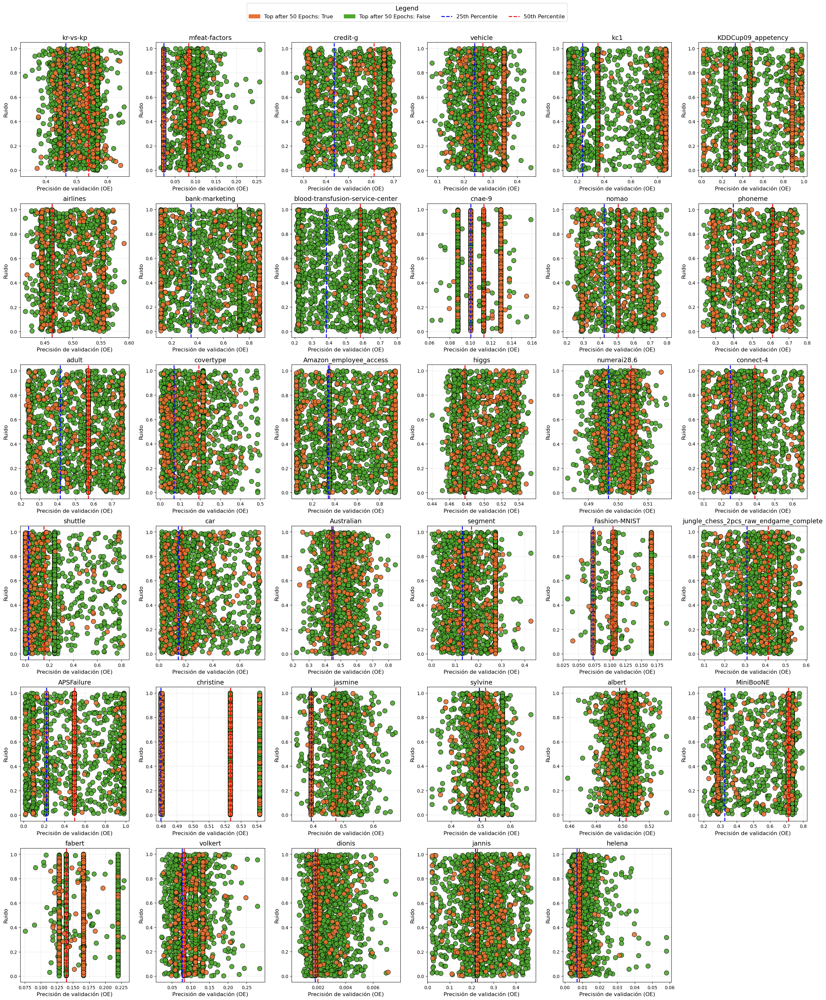

In [27]:
import matplotlib.patches as mpatches
import matplotlib.lines as mlines

n_datasets = len(datasets)
n_cols = 6
n_rows = (n_datasets + n_cols - 1) // n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(25, 5 * n_rows))
axes = axes.flatten()

for i, (dataset_name, dataset) in enumerate(datasets.items()):
    dataset_sorted = dataset.sort_values(by='Top_Model', ascending=True)
    ax = axes[i]

    # Plot without legend
    sns.scatterplot(data=dataset_sorted, x='OE_val_accuracy', y='noise',
                    hue='Top_Model', palette={True: '#E97132', False: '#4EA72E'},
                    edgecolor='black', alpha=0.9, s=100, ax=ax, legend=False)

    percentile_line_25 = np.percentile(dataset['OE_val_accuracy'], 25)
    percentile_line_50 = np.percentile(dataset['OE_val_accuracy'], 50)
    ax.axvline(percentile_line_25, color='blue', linestyle='dashed', linewidth=2)
    ax.axvline(percentile_line_50, color='red', linestyle='dashed', linewidth=2)

    ax.set_title(dataset_name, fontsize=14)
    ax.set_xlabel('Precisión de validación (OE)', fontsize=12)
    ax.set_ylabel('Ruido', fontsize=12)
    ax.grid(True, linestyle='--', alpha=0.4)

# Hide any unused axes
for i in range(n_datasets, len(axes)):
    axes[i].axis('off')

# ----- Build Custom Legend -----
# Color category patches
legend_patches = [
    mpatches.Patch(color='#E97132', label='Top after 50 Epochs: True'),
    mpatches.Patch(color='#4EA72E', label='Top after 50 Epochs: False')
]

# Percentile lines
legend_lines = [
    mlines.Line2D([], [], color='blue', linestyle='dashed', linewidth=2, label='25th Percentile'),
    mlines.Line2D([], [], color='red', linestyle='dashed', linewidth=2, label='50th Percentile')
]

# Combine all handles
legend_elements = legend_patches + legend_lines

# External legend
fig.legend(handles=legend_elements, title='Legend',
           loc='upper center', bbox_to_anchor=(0.5, 1.02),
           ncol=4, frameon=True, fontsize=12, title_fontsize=14)

plt.tight_layout(rect=[0, 0, 1, 0.99])
plt.savefig('../../figures/Top after 50 Epochs vs OE_35ds.png', format='png', dpi=150, bbox_inches='tight')
plt.show()


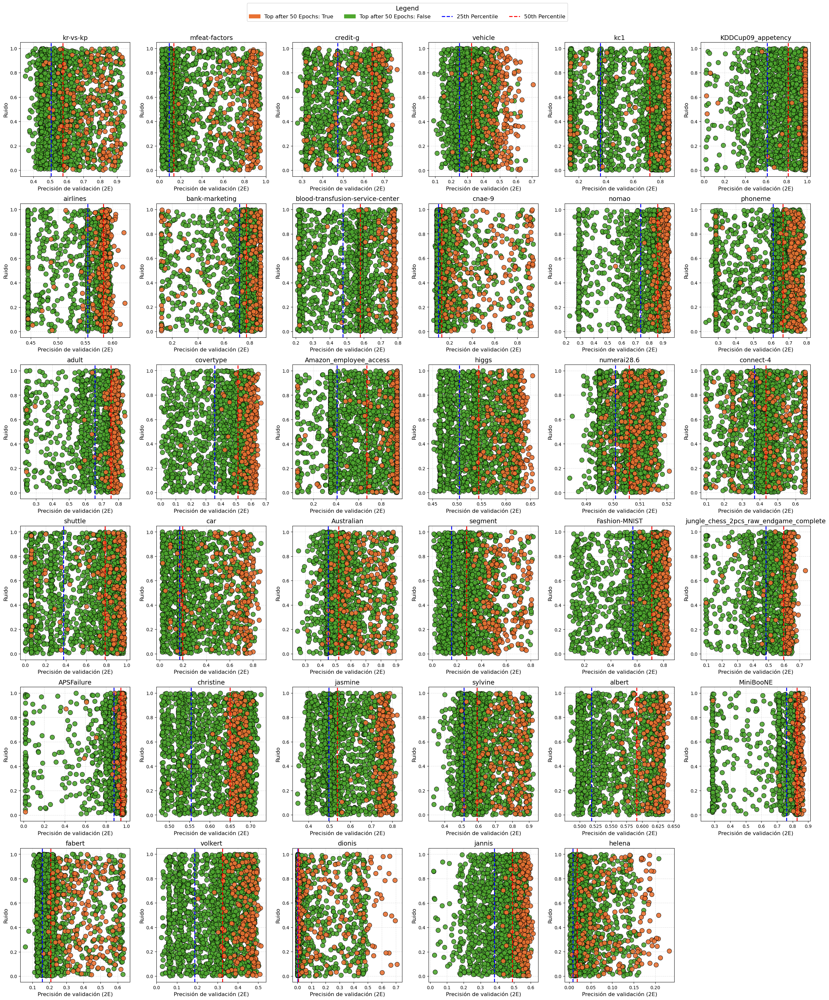

In [28]:

n_datasets = len(datasets)
n_cols = 6
n_rows = (n_datasets + n_cols - 1) // n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(25, 5 * n_rows))
axes = axes.flatten()

for i, (dataset_name, dataset) in enumerate(datasets.items()):
    dataset_sorted = dataset.sort_values(by='Top_Model', ascending=True)
    ax = axes[i]

    # Plot without legend
    sns.scatterplot(data=dataset_sorted, x='2E_val_accuracy', y='noise',
                    hue='Top_Model', palette={True: '#E97132', False: '#4EA72E'},
                    edgecolor='black', alpha=0.9, s=100, ax=ax, legend=False)

    percentile_line_25 = np.percentile(dataset['2E_val_accuracy'], 25)
    percentile_line_50 = np.percentile(dataset['2E_val_accuracy'], 50)
    ax.axvline(percentile_line_25, color='blue', linestyle='dashed', linewidth=2)
    ax.axvline(percentile_line_50, color='red', linestyle='dashed', linewidth=2)

    ax.set_title(dataset_name, fontsize=14)
    ax.set_xlabel('Precisión de validación (2E)', fontsize=12)
    ax.set_ylabel('Ruido', fontsize=12)
    ax.grid(True, linestyle='--', alpha=0.4)

# Hide any unused axes
for i in range(n_datasets, len(axes)):
    axes[i].axis('off')

# ----- Build Custom Legend -----
# Color category patches
legend_patches = [
    mpatches.Patch(color='#E97132', label='Top after 50 Epochs: True'),
    mpatches.Patch(color='#4EA72E', label='Top after 50 Epochs: False')
]

# Percentile lines
legend_lines = [
    mlines.Line2D([], [], color='blue', linestyle='dashed', linewidth=2, label='25th Percentile'),
    mlines.Line2D([], [], color='red', linestyle='dashed', linewidth=2, label='50th Percentile')
]

# Combine all handles
legend_elements = legend_patches + legend_lines

# External legend
fig.legend(handles=legend_elements, title='Legend',
           loc='upper center', bbox_to_anchor=(0.5, 1.02),
           ncol=4, frameon=True, fontsize=12, title_fontsize=14)

plt.tight_layout(rect=[0, 0, 1, 0.99])
plt.savefig('../../figures/Top after 50 Epochs vs 2E_35ds.png', format='png', dpi=150, bbox_inches='tight')
plt.show()


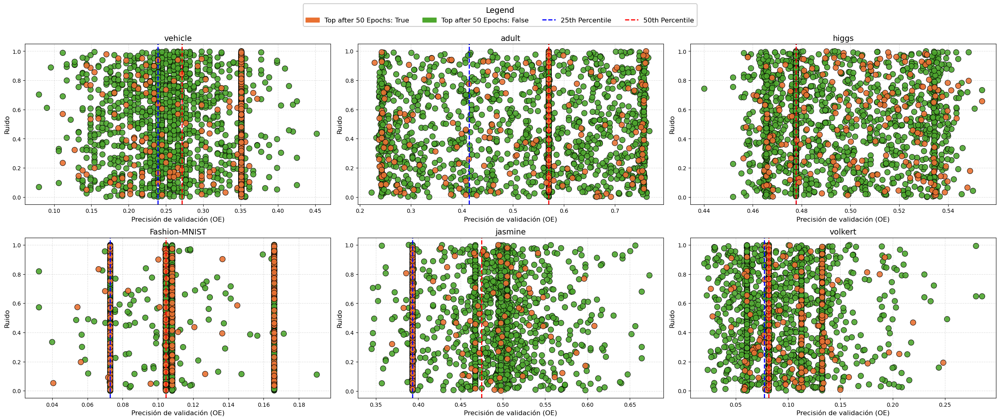

In [96]:
n_datasets = 6
n_cols = 3
n_rows = (n_datasets + n_cols - 1) // n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(25, 5 * n_rows))
axes = axes.flatten()
counter = 0
for i, (dataset_name, dataset) in enumerate(datasets.items()):
    if dataset_name in six_datasets:
        
        dataset_sorted = dataset.sort_values(by='Top_Model', ascending=True)
        ax = axes[counter]

        # Plot without legend
        sns.scatterplot(data=dataset_sorted, x='OE_val_accuracy', y='noise',
                        hue='Top_Model', palette={True: '#E97132', False: '#4EA72E'},
                        edgecolor='black', alpha=0.9, s=100, ax=ax, legend=False)

        percentile_line_25 = np.percentile(dataset['OE_val_accuracy'], 25)
        percentile_line_50 = np.percentile(dataset['OE_val_accuracy'], 50)
        ax.axvline(percentile_line_25, color='blue', linestyle='dashed', linewidth=2)
        ax.axvline(percentile_line_50, color='red', linestyle='dashed', linewidth=2)

        ax.set_title(dataset_name, fontsize=14)
        ax.set_xlabel('Precisión de validación (OE)', fontsize=12)
        ax.set_ylabel('Ruido', fontsize=12)
        ax.grid(True, linestyle='--', alpha=0.4)
        counter +=1 
    # Hide any unused axes
    for i in range(n_datasets, len(axes)):
        axes[i].axis('off')

    # ----- Build Custom Legend -----
    # Color category patches
    legend_patches = [
        mpatches.Patch(color='#E97132', label='Top after 50 Epochs: True'),
        mpatches.Patch(color='#4EA72E', label='Top after 50 Epochs: False')
    ]

    # Percentile lines
    legend_lines = [
        mlines.Line2D([], [], color='blue', linestyle='dashed', linewidth=2, label='25th Percentile'),
        mlines.Line2D([], [], color='red', linestyle='dashed', linewidth=2, label='50th Percentile')
    ]

    # Combine all handles
    legend_elements = legend_patches + legend_lines

    # External legend
    fig.legend(handles=legend_elements, title='Legend',
            loc='upper center', bbox_to_anchor=(0.5, 1.05),
            ncol=4, frameon=True, fontsize=12, title_fontsize=14)

plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.savefig('../../figures/Top after 50 Epochs vs OE_6ds.png', format='png', dpi=300, bbox_inches='tight')
plt.show()


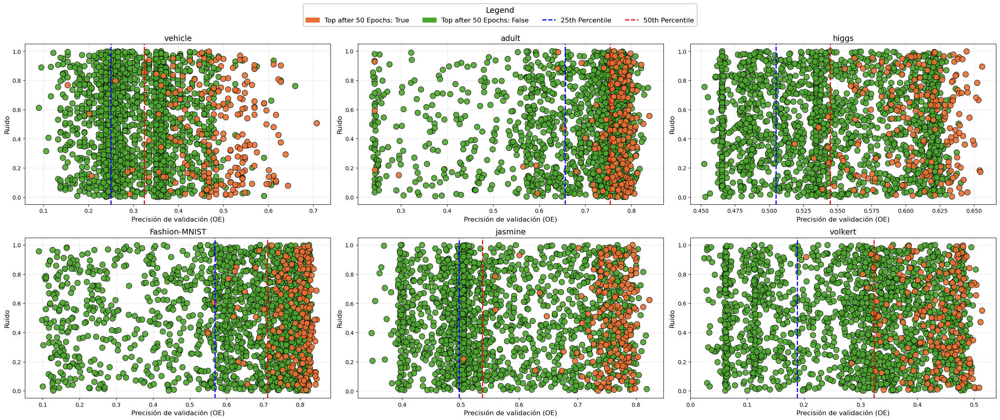

In [97]:
n_datasets = 6
n_cols = 3
n_rows = (n_datasets + n_cols - 1) // n_cols

fig, axes = plt.subplots(n_rows, n_cols, figsize=(25, 5 * n_rows))
axes = axes.flatten()
counter = 0
for i, (dataset_name, dataset) in enumerate(datasets.items()):
    if dataset_name in six_datasets:
        
        dataset_sorted = dataset.sort_values(by='Top_Model', ascending=True)
        ax = axes[counter]

        # Plot without legend
        sns.scatterplot(data=dataset_sorted, x='2E_val_accuracy', y='noise',
                        hue='Top_Model', palette={True: '#E97132', False: '#4EA72E'},
                        edgecolor='black', alpha=0.9, s=100, ax=ax, legend=False)

        percentile_line_25 = np.percentile(dataset['2E_val_accuracy'], 25)
        percentile_line_50 = np.percentile(dataset['2E_val_accuracy'], 50)
        ax.axvline(percentile_line_25, color='blue', linestyle='dashed', linewidth=2)
        ax.axvline(percentile_line_50, color='red', linestyle='dashed', linewidth=2)

        ax.set_title(dataset_name, fontsize=14)
        ax.set_xlabel('Precisión de validación (OE)', fontsize=12)
        ax.set_ylabel('Ruido', fontsize=12)
        ax.grid(True, linestyle='--', alpha=0.4)
        counter +=1 
    # Hide any unused axes
    for i in range(n_datasets, len(axes)):
        axes[i].axis('off')

    # ----- Build Custom Legend -----
    # Color category patches
    legend_patches = [
        mpatches.Patch(color='#E97132', label='Top after 50 Epochs: True'),
        mpatches.Patch(color='#4EA72E', label='Top after 50 Epochs: False')
    ]

    # Percentile lines
    legend_lines = [
        mlines.Line2D([], [], color='blue', linestyle='dashed', linewidth=2, label='25th Percentile'),
        mlines.Line2D([], [], color='red', linestyle='dashed', linewidth=2, label='50th Percentile')
    ]

    # Combine all handles
    legend_elements = legend_patches + legend_lines

    # External legend
    fig.legend(handles=legend_elements, title='Legend',
            loc='upper center', bbox_to_anchor=(0.5, 1.05),
            ncol=4, frameon=True, fontsize=12, title_fontsize=14)

plt.tight_layout(rect=[0, 0, 1, 0.98])
plt.savefig('../../figures/Top after 50 Epochs vs 2E_6ds.png', format='png', dpi=300, bbox_inches='tight')
plt.show()
